<!-- # Ross Sea synthetic gravity inversion -->

<!-- import packages -->

In [8]:
from __future__ import annotations

%load_ext autoreload
%autoreload 2

import shutil
import logging
import pathlib
import pickle
import verde as vd
import xarray as xr
import pandas as pd
import numpy as np
from polartoolkit import maps, fetch, regions, profiles
from polartoolkit import utils as polar_utils
import string
import copy
from tqdm.autonotebook import tqdm
import os
import RIS_gravity_inversion.synthetic as RIS_synth
import RIS_gravity_inversion.plotting as RIS_plotting
import pygmt
import scipy as sp
import itertools
import matplotlib.pyplot as plt
os.environ['POLARTOOLKIT_HEMISPHERE']='south'

logging.getLogger().setLevel(logging.INFO)

from invert4geom import inversion, plotting, synthetic, uncertainty, utils, regional, cross_validation, optimization

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


<!-- # Get synthetic model data -->

INFO:root:using preprocessed 5km grid since spacing is > 5km
INFO:root:returning grid with new region and/or registration, same spacing


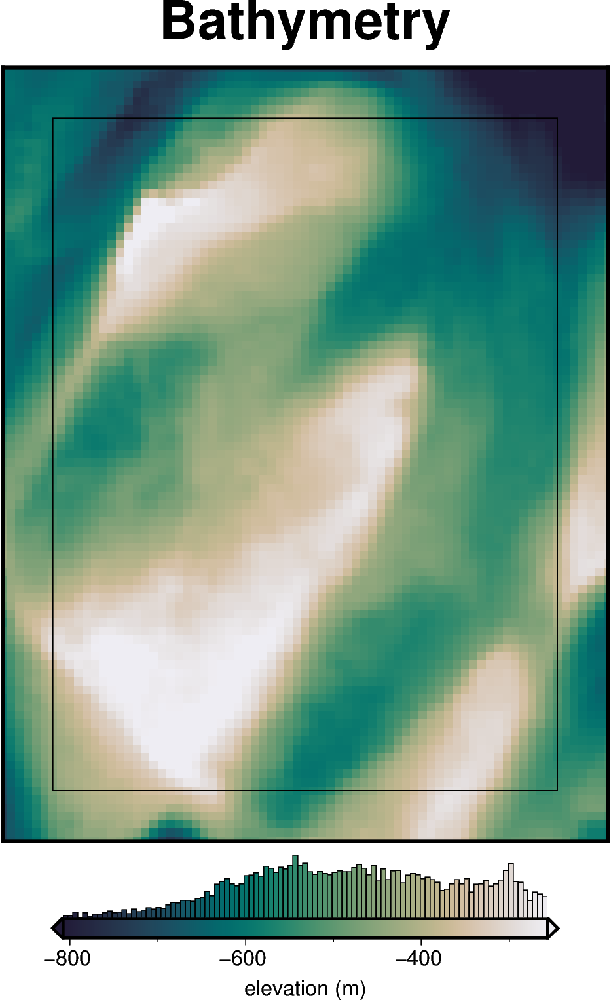

  0%|          | 0/4941 [00:00<?, ?it/s]

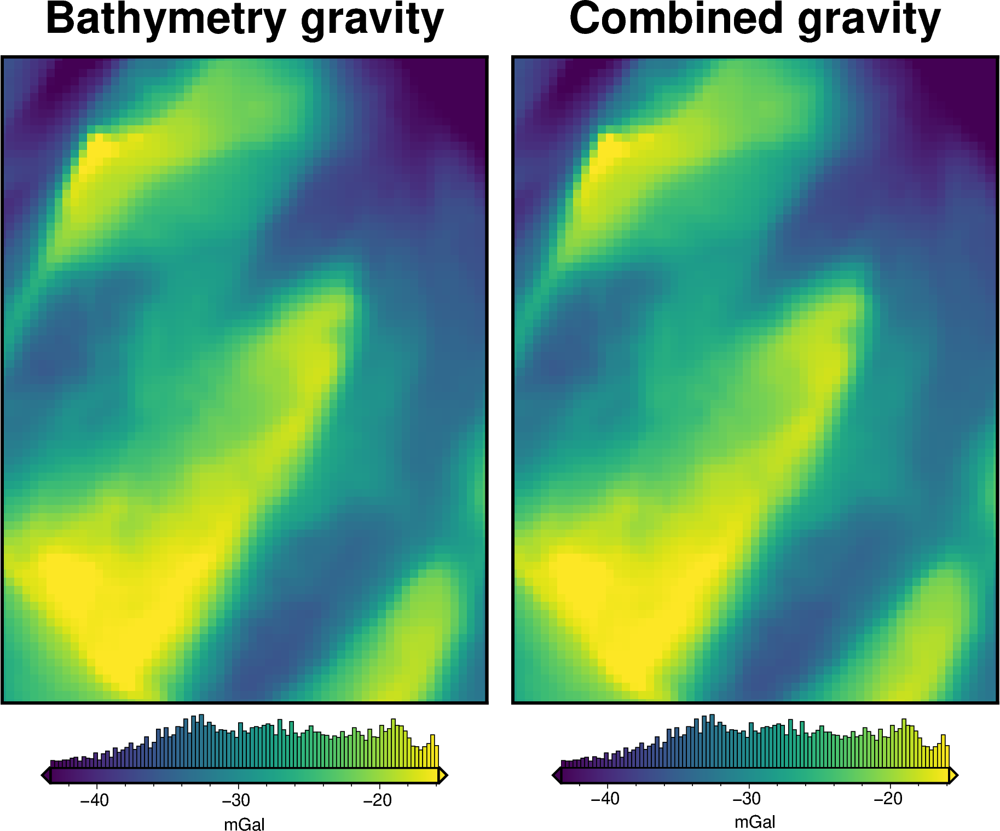

In [ ]:
# set grid parameters
spacing = 5e3
inversion_region = (-40e3, 260e3, -1800e3, -1400e3)

true_density_contrast = 1476

bathymetry, basement, original_grav_df = RIS_synth.load_synthetic_model(
    spacing=spacing,
    buffer=spacing*6,
    # basement=True,
    zref=0,
    bathymetry_density_contrast=true_density_contrast,
)
buffer_region = polar_utils.get_grid_info(bathymetry)[1]

# rename the full res gravity column
original_grav_df=original_grav_df.rename(columns={"gravity_anomaly": "gravity_anomaly_full_res_no_noise"})

In [10]:
# antgg = fetch.gravity(
#     region=inversion_region,
#     version="antgg-update",
#     anomaly_type="DG",
# )
# maps.plot_grd(
#     antgg,
#     cmap="viridis",
#     region=inversion_region,
#     hist=True,
#     title="AntGG gravity",
#     robust=True,
# )


In [4]:
original_grav_df.describe()

,northing,easting,upward,bathymetry_grav,basement_grav,disturbance,gravity_anomaly_full_res_no_noise
count,4.941000e+03,4941.00000,4941.0,4941.000000,4941.0,4941.000000,4941.000000
mean,-1.600000e+06,110000.00000,1000.0,-28.076339,0.0,-28.076339,-28.076339
std,1.169164e+05,88042.99419,0.0,7.267542,0.0,7.267542,7.267542
min,-1.800000e+06,-40000.00000,1000.0,-50.834525,0.0,-50.834525,-50.834525
25%,-1.700000e+06,35000.00000,1000.0,-33.380910,0.0,-33.380910,-33.380910
50%,-1.600000e+06,110000.00000,1000.0,-28.037682,0.0,-28.037682,-28.037682
75%,-1.500000e+06,185000.00000,1000.0,-21.983838,0.0,-21.983838,-21.983838
max,-1.400000e+06,260000.00000,1000.0,-13.088736,0.0,-13.088736,-13.088736


<!-- # Set filename -->

In [11]:
ensemble_path = f"../../results/09_grav_spacing_vs_noise_ensemble_no_regional"
ensemble_fname = f"{ensemble_path}.csv"

<!-- # Make starting bathymetry model -->

In [15]:
# semi-regularly spaced
constraint_points = RIS_synth.constraint_layout_number(
    shape=(4,5),
    region=inversion_region,
    padding=-spacing,
)

# sample true topography at these points
constraint_points = utils.sample_grids(
    constraint_points,
    bathymetry,
    "true_upward",
    coord_names=("easting", "northing"),
)
constraint_points["upward"] = constraint_points.true_upward
constraint_points.head()

,northing,easting,true_upward,upward
0,-1756000.0,1250.0,-277.117397,-277.117397
1,-1756000.0,73750.0,-292.754172,-292.754172
2,-1756000.0,146250.0,-587.490438,-587.490438
3,-1756000.0,218750.0,-303.910608,-303.910608
4,-1678000.0,1250.0,-356.930926,-356.930926


In [16]:
# grid the sampled values using verde
starting_topography_kwargs = dict(
    method="splines",
    region=buffer_region,
    spacing=spacing,
    constraints_df=constraint_points,
    dampings=None,
    # method="flat",
    # upwards=bathymetry.values.mean(),
    # region=buffer_region,
    # spacing=spacing,
)

starting_bathymetry = utils.create_topography(**starting_topography_kwargs)

starting_bathymetry

<xarray.DataArray 'scalars' (northing: 93, easting: 73)> Size: 54kB
array([[-306.27646204, -301.11328455, -296.14330811, ..., -136.72275749,
        -133.56247234, -130.90278552],
       [-309.23858022, -303.98041825, -298.91207899, ..., -141.4887454 ,
        -138.50192797, -136.02065391],
       [-312.27191015, -306.91508978, -301.74433524, ..., -146.43003056,
        -143.64038179, -141.35749105],
       ...,
       [-928.66251693, -917.88043654, -906.84555987, ..., -854.58896833,
        -862.85099753, -870.81154897],
       [-938.2697604 , -927.29383174, -916.05662461, ..., -859.61863513,
        -868.01943284, -876.12134531],
       [-947.80748693, -936.6526941 , -925.23245144, ..., -864.83953674,
        -873.35985613, -881.58608866]])
Coordinates:
  * easting   (easting) float64 584B -7e+04 -6.5e+04 -6e+04 ... 2.85e+05 2.9e+05
  * northing  (northing) float64 744B -1.83e+06 -1.825e+06 ... -1.37e+06
Attributes:
    metadata:  Generated by SplineCV(cv=KFold(n_splits=5, random_state=0, shu...
    damping:   None

In [8]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    starting_bathymetry,
    "starting_bathymetry",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.true_upward - constraint_points.starting_bathymetry)
print(f"RMSE: {rmse:.2f} m")

RMSE: 0.19 m


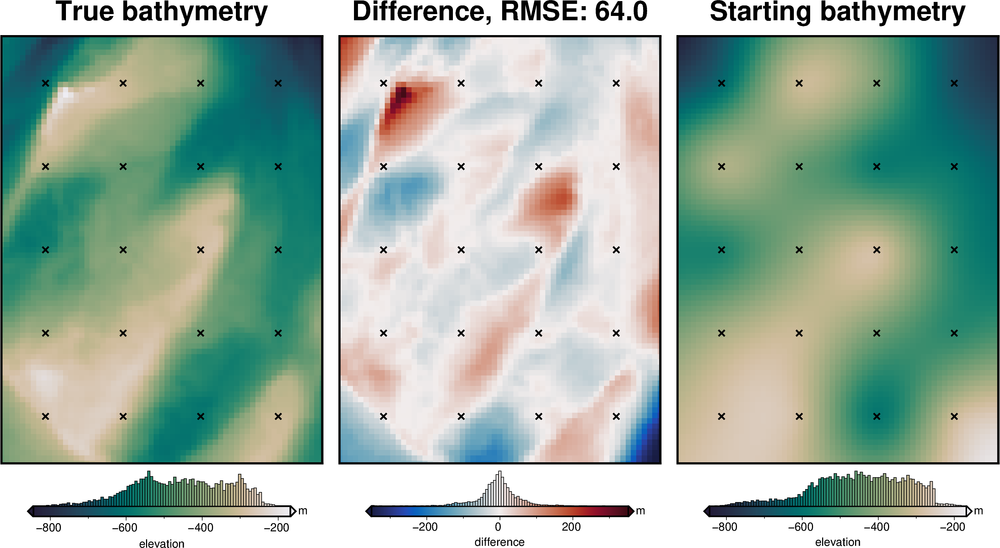

In [9]:
# compare starting and actual bathymetry grids
grids = polar_utils.grd_compare(
    bathymetry,
    starting_bathymetry,
    fig_height=10,
    plot=True,
    plot_type="pygmt",
    cmap="rain",
    reverse_cpt=True,
    diff_cmap="balance+h0",
    grid1_name="True bathymetry",
    grid2_name="Starting bathymetry",
    title="Difference",
    title_font="18p,Helvetica-Bold,black",
    cbar_unit="m",
    cbar_label="elevation",
    RMSE_decimals=0,
    region=inversion_region,
    inset=False,
    hist=True,
    cbar_yoffset=1,
    label_font="16p,Helvetica,black",
    points=constraint_points.rename(columns={"easting": "x", "northing": "y"}),
    points_style="x.2c",
)

In [10]:
# the true density contrast is 1476 kg/m3
# density_contrast = 1350
density_contrast = 1476

# set the reference level from the prisms to 0
zref = 0

density_grid = xr.where(
    starting_bathymetry >=  zref,
    density_contrast,
    -density_contrast,
)

# create layer of prisms
starting_prisms = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)

original_grav_df["starting_gravity"] = starting_prisms.prism_layer.gravity(
    coordinates=(
        original_grav_df.easting,
        original_grav_df.northing,
        original_grav_df.upward,
    ),
    field="g_z",
    progressbar=True,
)

original_grav_df

  0%|          | 0/4941 [00:00<?, ?it/s]

,northing,easting,upward,bathymetry_grav,basement_grav,disturbance,gravity_anomaly_full_res_no_noise,starting_gravity
0,-1800000.0,-40000.0,1000.0,-28.046289,0,-28.046289,-28.046289,-17.821792
1,-1800000.0,-35000.0,1000.0,-26.714502,0,-26.714502,-26.714502,-17.569720
2,-1800000.0,-30000.0,1000.0,-25.919276,0,-25.919276,-25.919276,-17.324115
3,-1800000.0,-25000.0,1000.0,-25.236960,0,-25.236960,-25.236960,-17.088070
4,-1800000.0,-20000.0,1000.0,-24.610928,0,-24.610928,-24.610928,-16.863889
...,...,...,...,...,...,...,...,...
4936,-1400000.0,240000.0,1000.0,-48.323584,0,-48.323584,-48.323584,-46.016261
4937,-1400000.0,245000.0,1000.0,-48.356131,0,-48.356131,-48.356131,-46.655929
4938,-1400000.0,250000.0,1000.0,-49.079005,0,-49.079005,-49.079005,-47.247896
4939,-1400000.0,255000.0,1000.0,-49.877171,0,-49.877171,-49.877171,-47.790857


<!-- # Run ensemble of inversions with varying survey line spacing and noise -->

In [11]:
num = 8 # CHANGE TO 8
log_num = num #+ 1

# Define number of flights lines on log scale
grav_line_numbers = np.unique(np.round(np.geomspace(3,30,num)))
grav_line_numbers = [int(i) for i in grav_line_numbers]
assert len(grav_line_numbers) == num

# Define noise levels for grav data
grav_noise_levels = [float(round(x,2)) for x in np.linspace(0, 6, num)]

print("number of grav lines:", grav_line_numbers)
print("grav noise levels:", grav_noise_levels)

number of grav lines: [3, 4, 6, 8, 11, 16, 22, 30]
grav noise levels: [0.0, 0.86, 1.71, 2.57, 3.43, 4.29, 5.14, 6.0]


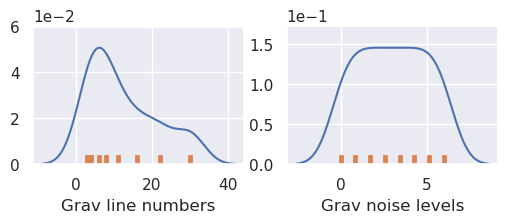

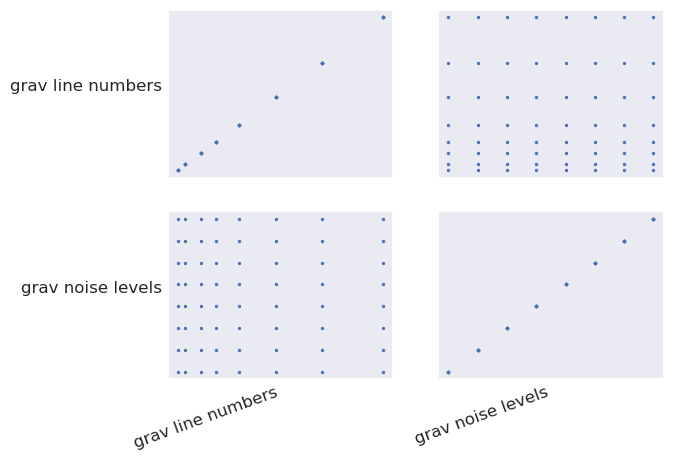

In [12]:
# turn into dataframe
sampled_params_df = pd.DataFrame(
    itertools.product(
        grav_line_numbers,
        grav_noise_levels,
    ),
    columns=[
        "grav_line_numbers",
        "grav_noise_levels",
    ],
)

sampled_params_dict = dict(
    grav_line_numbers=dict(sampled_values=sampled_params_df.grav_line_numbers),
    grav_noise_levels=dict(sampled_values=sampled_params_df.grav_noise_levels),
)

plotting.plot_latin_hypercube(
    sampled_params_dict,
)


<!-- # Create observed gravity
* sample full-res gravity along flight lines
* grid flight line data with equivalent sources

Only need to do this for unique grav_line_numbers  -->

In [13]:
sampled_params_df

,grav_line_numbers,grav_noise_levels
0,3,0.00
1,3,0.86
2,3,1.71
3,3,2.57
4,3,3.43
...,...,...
59,30,2.57
60,30,3.43
61,30,4.29
62,30,5.14


In [ ]:
logging.getLogger().setLevel(logging.WARNING)

sampled_params_df["grav_df_fname"] = pd.Series()
sampled_params_df["grav_survey_df_fname"] = pd.Series()
sampled_params_df["grav_line_spacing"] = pd.Series()
sampled_params_df["grav_eqs_damping"] = pd.Series()
sampled_params_df["grav_eqs_depth"] = pd.Series()
sampled_params_df["grav_eqs_score"] = pd.Series()

grav_grid = original_grav_df.set_index(['northing', 'easting']).to_xarray()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # set file names
    grav_df_fname = f"{ensemble_path}_grav_df_{i}.csv"
    grav_survey_df_fname = f"{ensemble_path}_grav_survey_df_{i}.csv"

    # check if grav_line_numbers is already done
    # if so, copy it
    subset_with_same_params = sampled_params_df[
        (sampled_params_df.grav_line_numbers == row.grav_line_numbers)
    ]

    if (len(subset_with_same_params) > 1) & (subset_with_same_params.grav_df_fname.iloc[0] is not np.nan):
        # copy and rename files
        shutil.copy(subset_with_same_params.grav_df_fname.iloc[0], grav_df_fname)
        shutil.copy(subset_with_same_params.grav_survey_df_fname.iloc[0], grav_survey_df_fname)

        # copy other columns
        sampled_params_df.loc[i, "grav_line_spacing"] = subset_with_same_params.grav_line_spacing.iloc[0]
        sampled_params_df.loc[i, "grav_eqs_damping"] = subset_with_same_params.grav_eqs_damping.iloc[0]
        sampled_params_df.loc[i, "grav_eqs_depth"] = subset_with_same_params.grav_eqs_depth.iloc[0]
        sampled_params_df.loc[i, "grav_eqs_score"] = subset_with_same_params.grav_eqs_score.iloc[0]
        print("skipping and using already create data")
    else:
        # new dataframe
        grav_df = copy.deepcopy(original_grav_df)

        # create flight lines
        grav_survey_df = RIS_synth.airborne_survey(
            along_line_spacing=1e3, ##### CHANGE THIS TO 1e3
            grav_observation_height=1e3,
            NS_line_number=row.grav_line_numbers,
            EW_line_number=row.grav_line_numbers,
            region=inversion_region,
            grav_grid=grav_df.set_index(["northing", "easting"]).to_xarray().gravity_anomaly_full_res_no_noise,
            # plot=True,
        )
        grav_survey_df=grav_survey_df.rename(columns={"gravity_anomaly": "gravity_anomaly_no_noise"})
        x_spacing=(inversion_region[1]-inversion_region[0])/row.grav_line_numbers
        y_spacing=(inversion_region[3]-inversion_region[2])/row.grav_line_numbers
        grav_line_spacing = ((x_spacing + y_spacing)/2)/1e3

        # grid the airborne survey data with equivalent sources
        eqs_study, eqs = optimization.optimize_eq_source_params(
            (grav_survey_df.easting, grav_survey_df.northing, grav_survey_df.upward),
            grav_survey_df.gravity_anomaly_no_noise,
            n_trials=8, ##### CHANGE THIS TO 8
            damping_limits=[1e-20, 1e-2],
            depth_limits=[100, 200e3],
            block_size=spacing*4,
            # plot=True,
            progressbar=False,
            fname=f"../../results/09_eqs.pkl",
        )
        #predict sources onto grid
        grav_df["eqs_gravity_anomaly"] = eqs.predict(
            (
                grav_df.easting,
                grav_df.northing,
                grav_df.upward,
            ),
        )
        grav_df["gravity_anomaly_no_noise"] = grav_df.eqs_gravity_anomaly

        # add to dataframe
        sampled_params_df.loc[i, "grav_line_spacing"] = grav_line_spacing
        sampled_params_df.loc[i, "grav_eqs_damping"] = eqs_study.best_trial.params["damping"]
        sampled_params_df.loc[i, "grav_eqs_depth"] = eqs_study.best_trial.params["depth"]
        sampled_params_df.loc[i, "grav_eqs_score"] = eqs_study.best_trial.value

        # save to files
        grav_survey_df.to_csv(grav_survey_df_fname, index=False)
        grav_df.to_csv(grav_df_fname, index=False)

    # add to dataframe
    sampled_params_df.loc[i, "grav_df_fname"] = grav_df_fname
    sampled_params_df.loc[i, "grav_survey_df_fname"] = grav_survey_df_fname

sampled_params_df.head()

  0%|          | 0/64 [00:00<?, ?it/s]

skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data


skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using already create data
skipping and using alread

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score
0,3,0.00,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,0.0,43253.784081,0.995289
1,3,0.86,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,0.0,43253.784081,0.995289
2,3,1.71,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,0.0,43253.784081,0.995289
3,3,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,0.0,43253.784081,0.995289
4,3,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,0.0,43253.784081,0.995289


In [15]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [16]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score
0,3,0.00,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
1,3,0.86,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
2,3,1.71,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
3,3,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
4,3,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289


<Axes: >

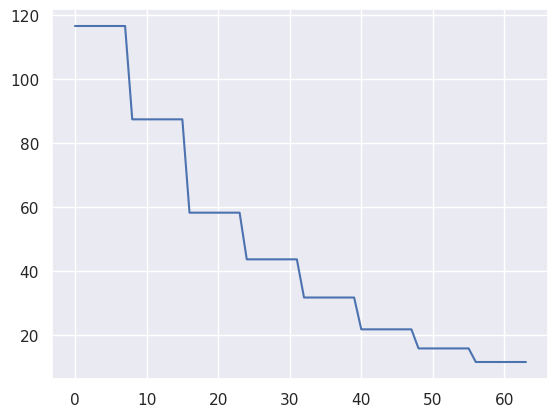

In [17]:
sampled_params_df.grav_line_spacing.plot()

<!-- # Add noise to gravity data -->

In [18]:
for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    # contaminated with long-wavelength noise
    contaminated = synthetic.contaminate_with_long_wavelength_noise(
        grav_df.set_index(["northing", "easting"]).to_xarray().gravity_anomaly_no_noise,
        coarsen_factor=None,
        spacing=50e3,
        noise_as_percent=False,
        noise=row.grav_noise_levels,
    )
    contaminated_df = vd.grid_to_table(contaminated.rename("gravity_anomaly_no_noise")).reset_index(drop=True)

    grav_df = pd.merge(
        grav_df.drop(columns=["gravity_anomaly_no_noise"], errors="ignore"),
        contaminated_df,
        on=["easting", "northing"],
    )

    # contaminate gravity with random noise
    grav_df["gravity_anomaly"], stddev = synthetic.contaminate(
        grav_df.gravity_anomaly_no_noise,
        stddev=row.grav_noise_levels,
        percent=False,
        seed=0
    )

    # add noise level to uncert column
    grav_df["uncert"] = row.grav_noise_levels

    # resave gravity dataframe
    grav_df.to_csv(row.grav_df_fname, index=False)

sampled_params_df.head()

  0%|          | 0/64 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score
0,3,0.00,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
1,3,0.86,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
2,3,1.71,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
3,3,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
4,3,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289


In [19]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [20]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score
0,3,0.00,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
1,3,0.86,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
2,3,1.71,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
3,3,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
4,3,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289


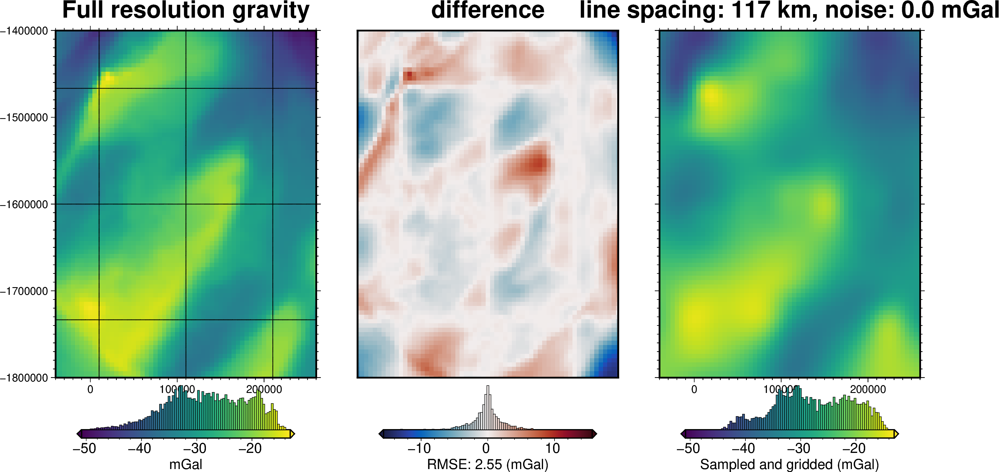

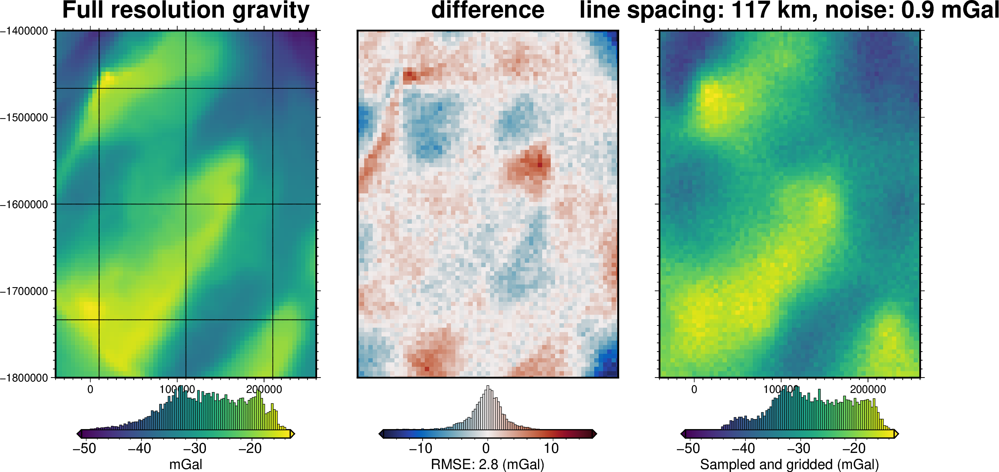

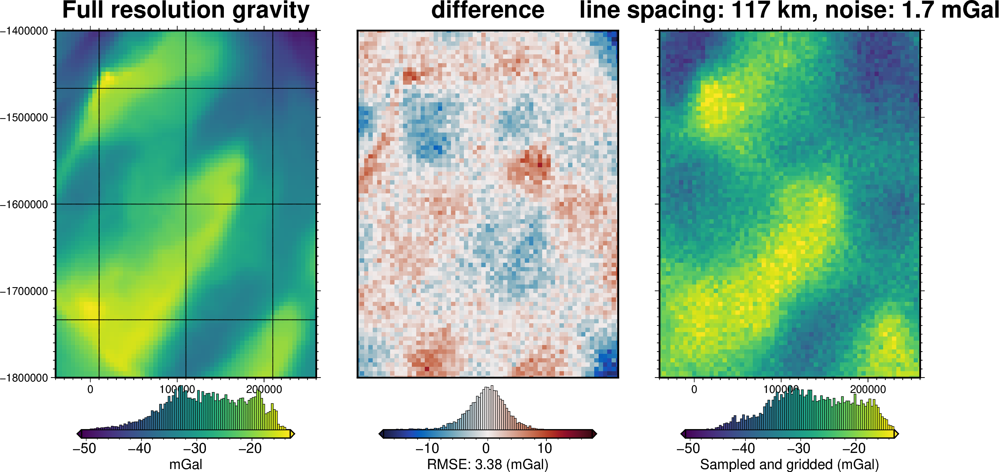

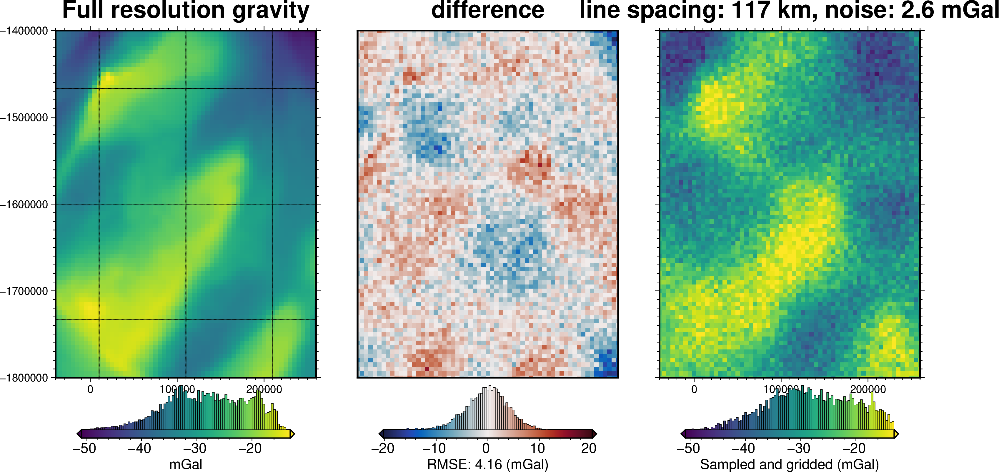

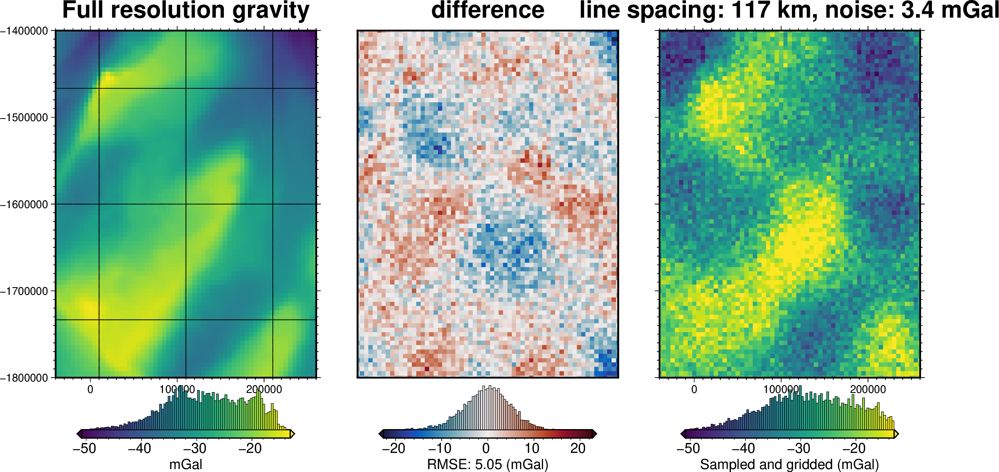

...

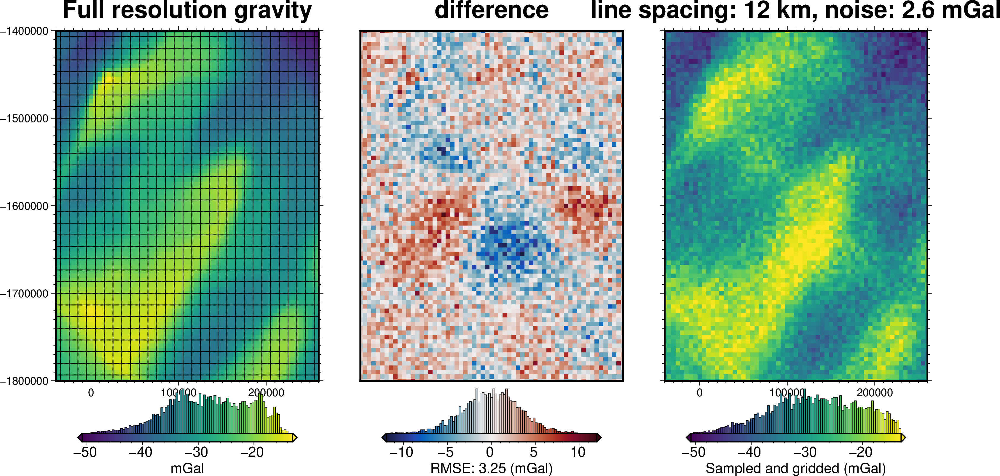

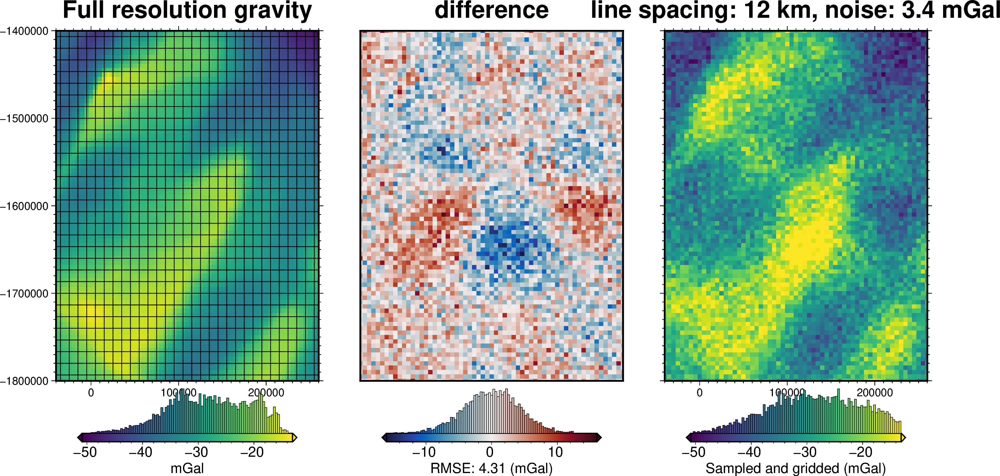

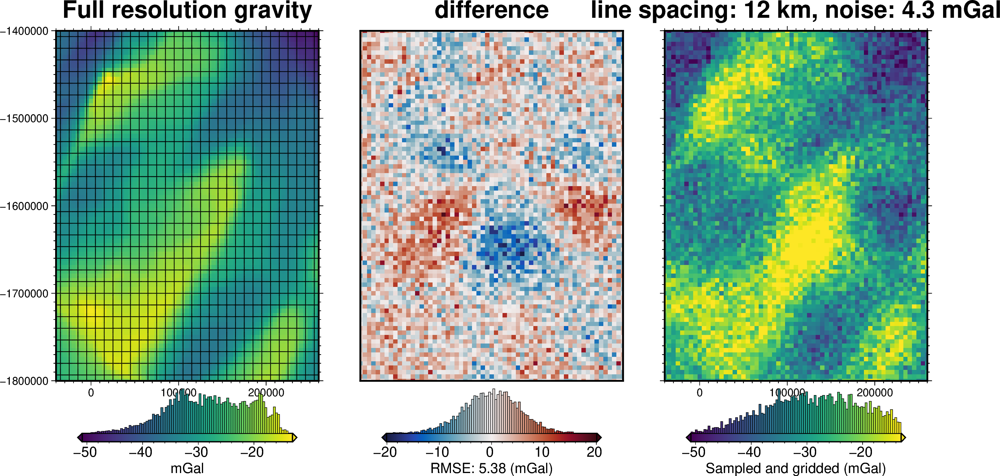

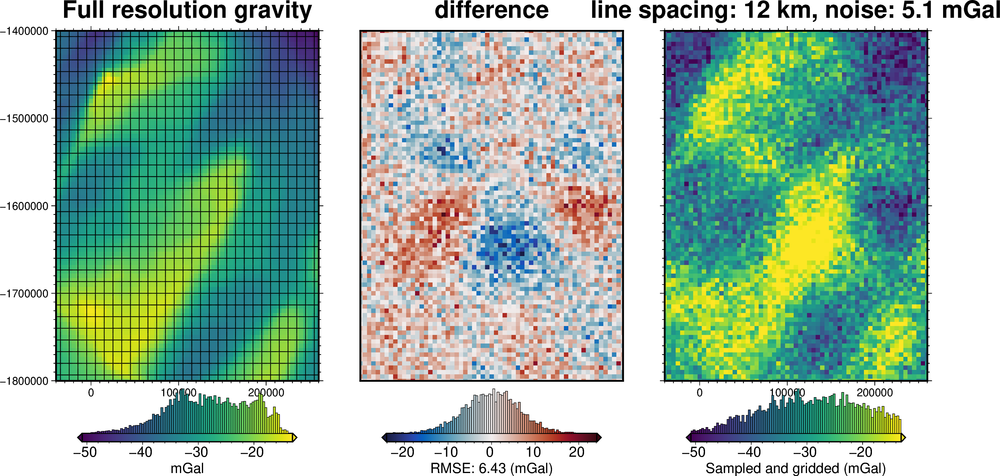

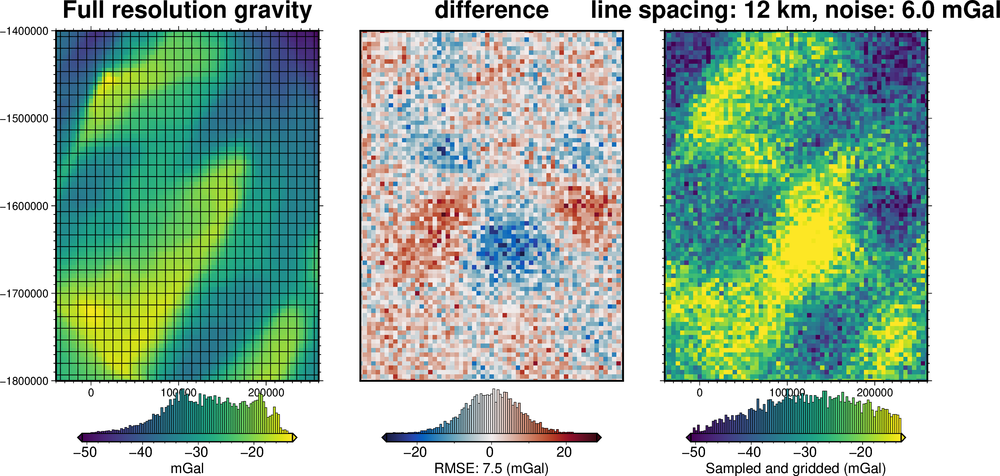

In [7]:
for i, row in sampled_params_df.iterrows():
    grav_survey_df = pd.read_csv(row.grav_survey_df_fname)
    grav_df = pd.read_csv(row.grav_df_fname)

    grav_grid = grav_df.set_index(['northing', 'easting']).to_xarray()

    # plot the synthetic gravity anomaly grid
    lims = polar_utils.get_min_max(grav_grid.gravity_anomaly_full_res_no_noise)

    fig = maps.plot_grd(
        grav_grid.gravity_anomaly_full_res_no_noise,
        fig_height=10,
        cmap="viridis",
        cpt_lims=lims,
        title="Full resolution gravity",
        cbar_label="mGal",
        cbar_font="18p,Helvetica,black",
        frame=["nSWe", "xaf10000", "yaf10000"],
        hist=True,
        cbar_yoffset=1.5,
    )
    # plot observation points
    fig.plot(
        grav_survey_df[["easting", "northing"]],
        style="c.02c",
        fill="black",
    )
    dif = (
        grav_grid.gravity_anomaly_full_res_no_noise - grav_grid.gravity_anomaly
    )
    fig = maps.plot_grd(
        dif,
        fig_height=10,
        cmap="balance+h0",
        cpt_lims=(-vd.maxabs(dif), vd.maxabs(dif)),
        title="difference",
        cbar_label=f"RMSE: {round(utils.rmse(dif),2)} (mGal)",
        cbar_font="18p,Helvetica,black",
        hist=True,
        cbar_yoffset=1.5,
        grd2_cpt=True,
        fig=fig,
        origin_shift="xshift",
        xshift_amount=1.1,
    )
    # plot the synthetic observed gravity grid
    fig = maps.plot_grd(
        grav_grid.gravity_anomaly,
        fig_height=10,
        cmap="viridis",
        cpt_lims=lims,
        title=f"line spacing: {round(row.grav_line_spacing)} km, noise: {round(row.grav_noise_levels,1)} mGal",
        cbar_label="Sampled and gridded (mGal)",
        cbar_font="18p,Helvetica,black",
        frame=["nSwe", "xaf10000", "yaf10000"],
        hist=True,
        cbar_yoffset=1.5,
        fig=fig,
        origin_shift="xshift",
        xshift_amount=1.1,
    )
    fig.show()

<!-- # Calculate starting gravity and misfit -->

In [22]:
logging.getLogger().setLevel(logging.WARNING)

# set regional to 0
regional_grav_kwargs = dict(
    method="constant",
    constant=0,
)

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    # add starting grav to dataframe
    grav_df["starting_gravity"] = original_grav_df.starting_gravity

    # calculate the true residual misfit
    grav_df["true_res"] = grav_df.bathymetry_grav - grav_df.starting_gravity

    # temporarily set some kwargs
    temp_reg_kwargs = copy.deepcopy(regional_grav_kwargs)

    grav_df = regional.regional_separation(
        grav_df=grav_df,
        **temp_reg_kwargs,
    )

    # resave gravity dataframe
    grav_df.to_csv(row.grav_df_fname, index=False)

sampled_params_df.head()

  0%|          | 0/64 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score
0,3,0.00,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
1,3,0.86,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
2,3,1.71,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
3,3,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
4,3,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289


In [23]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [24]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score
0,3,0.00,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
1,3,0.86,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
2,3,1.71,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
3,3,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289
4,3,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289


# Damping Cross Validation

In [25]:
logging.getLogger().setLevel(logging.WARNING)

sampled_params_df["damping_cv_results_fname"] = pd.Series()

for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):

    # load data
    grav_df = pd.read_csv(row.grav_df_fname)

    if row.grav_noise_levels == 0:
        l2_norm_tolerance = .3**.5
    else:
        l2_norm_tolerance = row.grav_noise_levels**.5

    # set kwargs to pass to the inversion
    kwargs = {
        # set stopping criteria
        "max_iterations": 200, #### CHANGE THIS TO 200
        "l2_norm_tolerance": l2_norm_tolerance, # square root of the gravity noise
        "delta_l2_norm_tolerance": 1.008,
    }

    # set results file name
    damping_cv_results_fname = f"{ensemble_path}_damping_cv_{i}"

    # run the inversion workflow, including a cross validation for the damping parameter
    _ = inversion.run_inversion_workflow(
        grav_df=grav_df,
        starting_prisms=starting_prisms,
        # for creating test/train splits
        grav_spacing=spacing,
        inversion_region=inversion_region,
        run_damping_cv=True,
        damping_limits=(0.001, 0.1),
        damping_cv_trials=8, ### CHANGE THIS TO 8
        # plot_cv=True,
        fname=damping_cv_results_fname,
        **kwargs,
    )

    # add results file name
    sampled_params_df.loc[i, "damping_cv_results_fname"] = damping_cv_results_fname

sampled_params_df.head()

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score,damping_cv_results_fname
0,3,0.00,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...
1,3,0.86,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...
2,3,1.71,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...
3,3,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...
4,3,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...


In [12]:
sampled_params_df["best_damping"] = pd.Series()
# sampled_params_df["constraints_damping_cv_rmse"] = pd.Series()
sampled_params_df["inversion_rmse"] = pd.Series()
sampled_params_df["inversion_mae"] = pd.Series()
sampled_params_df["inverted_bathymetry_fname"] = pd.Series()

for i, row in sampled_params_df.iterrows():

    # load saved inversion results
    with pathlib.Path(f"{row.damping_cv_results_fname}_results.pickle").open("rb") as f:
        results = pickle.load(f)

    # load study
    with pathlib.Path(f"{row.damping_cv_results_fname}_damping_cv_study.pickle").open("rb") as f:
        study = pickle.load(f)

    # collect the results
    topo_results, grav_results, parameters, elapsed_time = results
    final_bathymetry = topo_results.set_index(["northing", "easting"]).to_xarray().topo

    # add best damping to dataframe
    sampled_params_df.loc[i, "best_damping"] = parameters.get("Solver damping")

    # if row.grav_line_spacing==175:
    # if row.grav_noise_levels==0:
    #     plotting.plot_convergence(
    #         grav_results,
    #         params=parameters,
    #     )

    #     plotting.plot_cv_scores(
    #             study.trials_dataframe().value.values,
    #             study.trials_dataframe().params_damping.values,
    #             param_name="Damping",
    #             logx=True,
    #             logy=True,
    #         )

    #     plotting.plot_inversion_results(
    #         grav_results,
    #         topo_results,
    #         parameters,
    #         inversion_region,
    #         iters_to_plot=2,
    #         # plot_iter_results=False,
    #         plot_topo_results=False,
    #         plot_grav_results=False,
    #     )

    #     _ = polar_utils.grd_compare(
    #         bathymetry,
    #         final_bathymetry,
    #         region=inversion_region,
    #         plot=True,
    #         grid1_name="True topography",
    #         grid2_name="Inverted topography",
    #         robust=True,
    #         hist=True,
    #         inset=False,
    #         verbose="q",
    #         title="difference",
    #         grounding_line=False,
    #         reverse_cpt=True,
    #         cmap="rain",
    #         # points=constraint_points.rename(columns={"easting": "x", "northing": "y"}),
    #         # points_style="x.2c",
    #     )

    # # sample the inverted topography at the constraint points
    # constraint_points = utils.sample_grids(
    #     constraint_points,
    #     final_bathymetry,
    #     "inverted_damping_cv_bathymetry",
    #     coord_names=("easting", "northing"),
    # )
    # constraints_rmse = utils.rmse(constraint_points.true_upward - constraint_points.inverted_damping_cv_bathymetry)
    bathymetry_inner = bathymetry.sel(
        easting=slice(inversion_region[0], inversion_region[1]),
        northing=slice(inversion_region[2], inversion_region[3]),
    )
    final_bathymetry_inner = final_bathymetry.sel(
        easting=slice(inversion_region[0], inversion_region[1]),
        northing=slice(inversion_region[2], inversion_region[3]),
    )
    inversion_rmse = utils.rmse(bathymetry_inner - final_bathymetry_inner)
    inversion_mae = float(np.mean(np.abs(bathymetry_inner - final_bathymetry_inner)))

    # save final topography to file
    inverted_bathymetry_fname = f"{ensemble_path}_inverted_damping_cv_bathymetry_{i}.nc"
    final_bathymetry.to_netcdf(inverted_bathymetry_fname)

    # add to dataframe
    sampled_params_df.loc[i, "inverted_bathymetry_fname"] = inverted_bathymetry_fname
    # sampled_params_df.loc[i, "constraints_damping_cv_rmse"] = constraints_rmse
    sampled_params_df.loc[i, "inversion_rmse"] = inversion_rmse
    sampled_params_df.loc[i, "inversion_mae"] = inversion_mae

sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score,damping_cv_results_fname,best_damping,inversion_rmse,inverted_bathymetry_fname,regional_error,regional_rms,topo_improvement,inversion_mae
0,3,0.00,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.024578,45.585295,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,62.199868,30.19091
1,3,0.86,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.024578,51.854452,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,55.930710,37.376441
2,3,1.71,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.021902,68.371279,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,39.413883,52.581672
3,3,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.021551,89.285161,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,18.500001,70.103049
4,3,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.020706,113.565187,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,-5.780024,89.88796


In [13]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [28]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score,damping_cv_results_fname,best_damping,inversion_rmse,inverted_bathymetry_fname
0,3,0.00,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.024578,45.585295,../../results/09_grav_spacing_vs_noise_ensembl...
1,3,0.86,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.024578,51.854452,../../results/09_grav_spacing_vs_noise_ensembl...
2,3,1.71,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.021902,68.371279,../../results/09_grav_spacing_vs_noise_ensembl...
3,3,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.021551,89.285161,../../results/09_grav_spacing_vs_noise_ensembl...
4,3,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.020706,113.565187,../../results/09_grav_spacing_vs_noise_ensembl...


<!-- ## Density CV -->

In [29]:
# sampled_params_df["density_cv_results_fname"] = pd.Series()

# for i, row in tqdm(sampled_params_df.iterrows(), total=len(sampled_params_df)):
#     # load data
#     grav_df = pd.read_csv(row.grav_df_fname)

#     # temporarily set some regional kwargs
#     temp_reg_kwargs = copy.deepcopy(regional_grav_kwargs)
#     temp_reg_kwargs["constraints_df"] = constraint_points
#     # temp_reg_kwargs["cv_kwargs"]["fname"] = f"tmp/09_regional_sep_{i}"

#     density_cv_results_fname = f"../../results/Ross_Sea_09_density_cv_{i}"

#     if row.grav_noise_levels == 0:
#         l2_norm_tolerance = .3**.5
#     else:
#         l2_norm_tolerance = row.grav_noise_levels**.5

#     # set kwargs to pass to the inversion
#     kwargs = {
#         # set stopping criteria
#         "max_iterations": 200, #### CHANGE THIS TO 200
#         "l2_norm_tolerance": l2_norm_tolerance, # square root of the gravity noise
#         "delta_l2_norm_tolerance": 1.008,
#     }

#     # run a 5-fold cross validation for 8 parameter sets of density
#     # this performs 40 regional separations and 40 inversions
#     study, inversion_results = optimization.optimize_inversion_zref_density_contrast_kfolds(
#         grav_df=grav_df,
#         solver_damping=row.best_damping,
#         constraints_df=constraint_points,
#         density_contrast_limits=(1300, 1600),
#         zref=0,
#         n_trials=8, # CHANGE THIS TO 10
#         split_kwargs=dict(
#             n_splits=5, # CHANGE THIS TO 5
#             method="KFold",
#         ),
#         regional_grav_kwargs=temp_reg_kwargs,
#         starting_topography_kwargs=starting_topography_kwargs,
#         fname=density_cv_results_fname,
#         fold_progressbar=False,
#         plot_cv=False,
#         **kwargs,
#     )

#     # add results file name
#     sampled_params_df.loc[i, "density_cv_results_fname"] = density_cv_results_fname

# sampled_params_df.head()

In [30]:
# sampled_params_df.to_csv(ensemble_fname, index=False)

In [31]:
# sampled_params_df = pd.read_csv(ensemble_fname)
# sampled_params_df.head()

In [32]:
# sampled_params_df["best_density"] = pd.Series()
# sampled_params_df["constraints_density_cv_rmse"] = pd.Series()
# sampled_params_df["inversion_density_cv_rmse"] = pd.Series()

# for i, row in sampled_params_df.iterrows():
#     # load saved inversion results
#     with pathlib.Path(f"{row.density_cv_results_fname}_results.pickle").open("rb") as f:
#         results = pickle.load(f)

#     # load study
#     with pathlib.Path(f"{row.density_cv_results_fname}_study.pickle").open("rb") as f:
#         study = pickle.load(f)

#     # collect the results
#     topo_results, grav_results, parameters, elapsed_time = results
#     final_bathymetry = topo_results.set_index(["northing", "easting"]).to_xarray().topo

#     # add best damping to dataframe
#     sampled_params_df.loc[i, "best_density"] = study.best_params["density_contrast"]

#     plotting.plot_convergence(
#         grav_results,
#         params=parameters,
#     )

#     plotting.plot_cv_scores(
#             study.trials_dataframe().value.values,
#             study.trials_dataframe().params_density_contrast.values,
#             param_name="Density contrast (kg/m$^3$)",
#             plot_title="Density contrast Cross-validation",
#             logx=False,
#             logy=False,
#         )

#     plotting.plot_inversion_results(
#         grav_results,
#         topo_results,
#         parameters,
#         inversion_region,
#         iters_to_plot=2,
#         # plot_iter_results=False,
#         plot_topo_results=False,
#         plot_grav_results=False,
#     )

#     _ = polar_utils.grd_compare(
#         bathymetry,
#         final_bathymetry,
#         region=inversion_region,
#         plot=True,
#         grid1_name="True topography",
#         grid2_name="Inverted topography",
#         robust=True,
#         hist=True,
#         inset=False,
#         verbose="q",
#         title="difference",
#         grounding_line=False,
#         reverse_cpt=True,
#         cmap="rain",
#         points=constraint_points.rename(columns={"easting": "x", "northing": "y"}),
#         points_style="x.2c",
#     )

#     # sample the inverted topography at the constraint points
#     constraint_points = utils.sample_grids(
#         constraint_points,
#         final_bathymetry,
#         "inverted_density_cv_bathymetry",
#         coord_names=("easting", "northing"),
#     )
#     constraints_rmse = utils.rmse(constraint_points.true_upward - constraint_points.inverted_density_cv_bathymetry)
#     bathymetry_inner = bathymetry.sel(
#         easting=slice(inversion_region[0], inversion_region[1]),
#         northing=slice(inversion_region[2], inversion_region[3]),
#     )
#     final_bathymetry_inner = final_bathymetry.sel(
#         easting=slice(inversion_region[0], inversion_region[1]),
#         northing=slice(inversion_region[2], inversion_region[3]),
#     )
#     inversion_rmse = utils.rmse(bathymetry_inner - final_bathymetry_inner)

#     # save final topography to file
#     inverted_bathymetry_fname = f"{ensemble_path}_inverted_density_cv_bathymetry_{i}.nc"
#     final_bathymetry.to_netcdf(inverted_bathymetry_fname)

#     # add to dataframe
#     sampled_params_df.loc[i, "inverted_density_cv_bathymetry_fname"] = inverted_bathymetry_fname
#     sampled_params_df.loc[i, "constraints_density_cv_rmse"] = constraints_rmse
#     sampled_params_df.loc[i, "inversion_density_cv_rmse"] = inversion_rmse

# sampled_params_df.head()

In [18]:
sampled_params_df["regional_error"] = pd.Series()
sampled_params_df["regional_rms"] = pd.Series()

for i, row in sampled_params_df.iterrows():
    grav_df = pd.read_csv(row.grav_df_fname)

    sampled_params_df.loc[i, "regional_error"] = utils.rmse(grav_df.basement_grav - grav_df.reg)
    sampled_params_df.loc[i, "regional_rms"] = utils.rmse(grav_df.basement_grav)

starting_bathymetry_rmse = utils.rmse(bathymetry - starting_bathymetry)
starting_bathymetry_mae = float(np.mean(np.abs(bathymetry - starting_bathymetry)))

sampled_params_df["topo_improvement_rmse"] = starting_bathymetry_rmse - sampled_params_df.inversion_rmse
sampled_params_df["topo_improvement_mae"] = starting_bathymetry_mae - sampled_params_df.inversion_mae


sampled_params_df#.head()

,grav_line_numbers,grav_noise_levels,grav_df_fname,grav_survey_df_fname,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score,damping_cv_results_fname,best_damping,inversion_rmse,inverted_bathymetry_fname,regional_error,regional_rms,topo_improvement,inversion_mae,topo_improvement_rmse,topo_improvement_mae
0,3,0.00,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.024578,45.585295,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,62.199868,30.19091,62.199868,39.679847
1,3,0.86,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.024578,51.854452,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,55.930710,37.376441,55.93071,32.494316
2,3,1.71,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.021902,68.371279,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,39.413883,52.581672,39.413883,17.289085
3,3,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.021551,89.285161,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,18.500001,70.103049,18.500001,-0.232292
4,3,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,116.666667,3.385434e-14,43253.784081,0.995289,../../results/09_grav_spacing_vs_noise_ensembl...,0.020706,113.565187,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,-5.780024,89.88796,-5.780024,-20.017204
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,30,2.57,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,11.666667,1.437394e-20,111868.144128,0.995273,../../results/09_grav_spacing_vs_noise_ensembl...,0.021317,77.61056,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,30.174603,62.222999,30.174603,7.647758
60,30,3.43,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,11.666667,1.437394e-20,111868.144128,0.995273,../../results/09_grav_spacing_vs_noise_ensembl...,0.021203,103.117896,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,4.667267,82.706856,4.667267,-12.836099
61,30,4.29,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,11.666667,1.437394e-20,111868.144128,0.995273,../../results/09_grav_spacing_vs_noise_ensembl...,0.020605,130.216862,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,-22.431699,104.475426,-22.431699,-34.604669
62,30,5.14,../../results/09_grav_spacing_vs_noise_ensembl...,../../results/09_grav_spacing_vs_noise_ensembl...,11.666667,1.437394e-20,111868.144128,0.995273,../../results/09_grav_spacing_vs_noise_ensembl...,0.020538,155.932323,../../results/09_grav_spacing_vs_noise_ensembl...,0.0,0.0,-48.147161,125.126848,-48.147161,-55.256092


In [19]:
sampled_params_df.to_csv(ensemble_fname, index=False)

In [63]:
ensemble_fname[0:-4]

'../../results/09_grav_spacing_vs_noise_ensemble_no_regional'

In [64]:
# sampled_params_df.to_csv(f"{ensemble_fname[0:-4]}_backup.csv", index=False)

In [20]:
sampled_params_df = pd.read_csv(ensemble_fname)
sampled_params_df.describe()

,grav_line_numbers,grav_noise_levels,grav_line_spacing,grav_eqs_damping,grav_eqs_depth,grav_eqs_score,best_damping,inversion_rmse,regional_error,regional_rms,topo_improvement,inversion_mae,topo_improvement_rmse,topo_improvement_mae
count,64.000000,64.000000,64.000000,6.400000e+01,64.000000,64.000000,64.000000,64.000000,64.0,64.0,64.000000,64.000000,64.000000,64.000000
mean,12.500000,3.000000,48.439867,1.662625e-13,91464.191020,0.996130,0.022191,97.751158,0.0,0.0,10.034005,77.335002,10.034005,-7.464246
std,8.986763,1.979488,35.083498,2.142701e-13,45643.194615,0.000941,0.002260,54.867692,0.0,0.0,54.867692,44.940354,54.867692,44.940354
min,3.000000,0.000000,11.666667,1.000000e-20,43253.784081,0.995273,0.020042,12.819677,0.0,0.0,-80.487908,8.416328,-80.487908,-81.452165
25%,5.500000,1.497500,20.383523,1.437394e-20,51695.365784,0.995405,0.020596,51.880848,0.0,0.0,-35.326343,40.883484,-35.326343,-44.936592
50%,9.500000,3.000000,37.784091,2.543341e-14,86138.658714,0.995757,0.021271,96.880755,0.0,0.0,10.904408,77.383332,10.904408,-7.512575
75%,17.500000,4.502500,65.625000,3.298754e-13,111868.144128,0.996634,0.022831,143.111505,0.0,0.0,55.904315,114.807349,55.904315,28.987273
max,30.000000,6.000000,116.666667,5.036396e-13,189055.406831,0.998172,0.028333,188.273071,0.0,0.0,94.965486,151.322921,94.965486,61.454429


In [21]:
polar_utils.get_min_max(sampled_params_df.inversion_rmse, robust=True)

(np.float64(13.001972340478408), np.float64(187.1825151277898))

In [22]:
polar_utils.get_min_max(sampled_params_df.inversion_rmse, robust=False)

(np.float64(12.81967707540949), np.float64(188.2730709807513))

In [46]:
inversion_rmse_lims = polar_utils.get_min_max(sampled_params_df.inversion_rmse, robust=True)
inversion_rmse_lims

(np.float64(13.001972340478408), np.float64(187.1825151277898))

In [41]:
line_plot_inversion_rmse_lims = (13, 240)

In [55]:
starting_bathymetry_mae

69.87075685126707

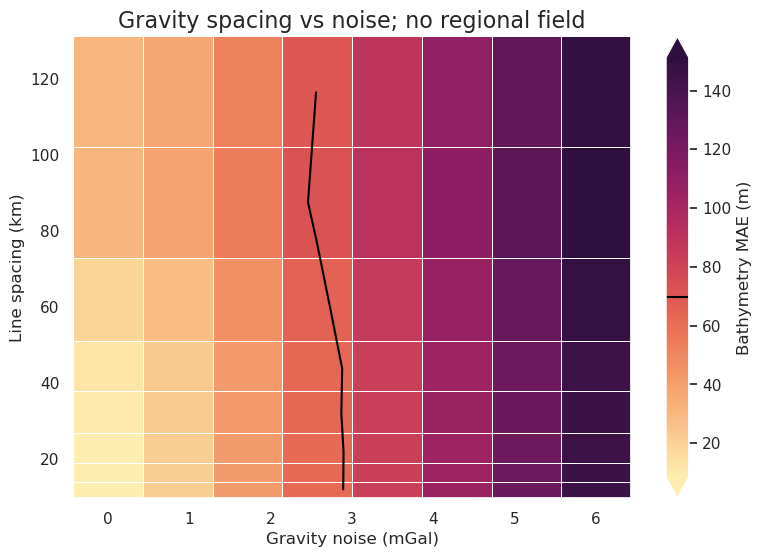

In [50]:
fig = RIS_plotting.plot_2var_ensemble(
    sampled_params_df,
    x="grav_noise_levels",
    y="grav_line_spacing",
    x_title="Gravity noise (mGal)",
    y_title="Line spacing (km)",

    background="inversion_mae",
    background_title="Bathymetry MAE (m)",

    # background_robust=True,
    # background_cpt_lims=[inversion_rmse_lims[0],starting_bathymetry_rmse*2],
    plot_contours=[starting_bathymetry_mae],
    plot_title="Gravity spacing vs noise; no regional field",
)
# Results
# expected relationship between noise, line spacing and performance
# inversion only offers improvement for noise < 5mGal

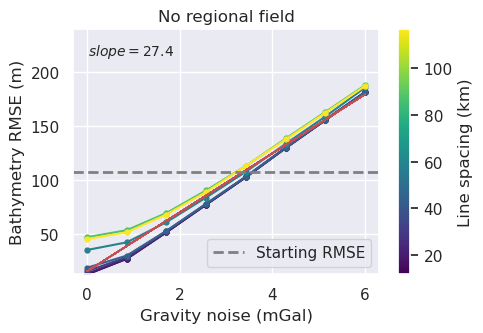

In [42]:
RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    y="inversion_rmse",
    x="grav_noise_levels",
    groupby_col="grav_line_spacing",
    x_label="Gravity noise (mGal)",
    cbar_label="Line spacing (km)",
    trend_line=True,
    horizontal_line=starting_bathymetry_rmse,
    horizontal_line_label="Starting RMSE",
    horizontal_line_label_loc="lower right",
    plot_title="No regional field",
    y_lims=line_plot_inversion_rmse_lims,
)
# Results
# linear relationship between noise and performance for all line spacings
# at high noise levels, lines spacing doesn't matter

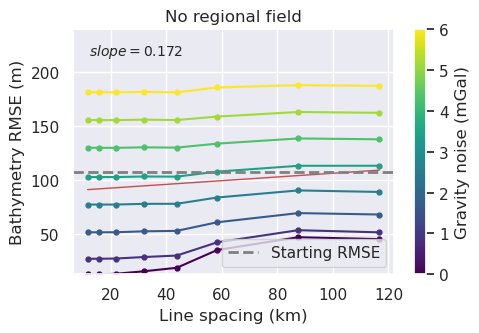

In [43]:
RIS_plotting.plot_ensemble_as_lines(
    sampled_params_df,
    y="inversion_rmse",
    x="grav_line_spacing",
    groupby_col="grav_noise_levels",
    x_label="Line spacing (km)",
    cbar_label="Gravity noise (mGal)",
    trend_line=True,
    horizontal_line=starting_bathymetry_rmse,
    horizontal_line_label="Starting RMSE",
    horizontal_line_label_loc="lower right",
    plot_title="No regional field",
    y_lims=line_plot_inversion_rmse_lims,
)
# Results
# linear relationship between line spacing and performance for all noise levels
# even at low line spacings, noise still matters
# noise is slightly more important at smaller line spacings

# Noise is more important than line spacing!!